In [19]:
# import:
import random
import itertools
import math
import matplotlib.pyplot as plt
from os import stat
import numpy as np

# indexing:
STARTING = 0
DESTINATION = 1
COLUMN = 0
ROW = 1

# adjustable variables:
n_cols = 11                                     # +2 for the "standing" slot        # number of columns of the street
n_rows = 1                                                                          # number of rows of the street
num_of_pedestrian = 4                                                               # number of pedestrians
sl_coverage = 1                                                                     # street light coverage area (excluding the light)
md_coverage = 1                                                                     # motion detection coverage area (excluding the light)
brightness_lvl_lowest = 1                                                           # lowest brightness level
brightness_lvl_highest = 3                                                          # highest brightness level
nl_opt = [[1],[2],[3],[2],[1]]                                                      # natural light level (3 = darkest)
episodes = 6000
# bounded variables:
positions = [(0,(n_rows - 1)), ((n_cols - 1), (n_rows - 1))]                        # number of end points
tds = list(range(1, (num_of_pedestrian + 1)))                                       # list of time delay
brightness_lvl = list(range(brightness_lvl_lowest, (brightness_lvl_highest + 1)))   # list of brightness level

In [20]:
class PedestriansMaker():
    
    def __init__(self, n_cols, n_rows, positions, num_of_pedestrian, tds):
        self.n_cols = n_cols
        self.n_rows = n_rows
        self.positions = positions
        self.num_of_pedestrian = num_of_pedestrian
        self.tds = tds
        self.list_sd = self.create_starting_destination(self.positions)
        self.pedestrians_sd = self.create_pedestrians_sd(self.num_of_pedestrian, self.list_sd)
        self.pedestrians_s = self.pedestrians_sd[STARTING]
        self.pedestrians_d = self.pedestrians_sd[DESTINATION]
        self.pedestrians_pathway = self.create_pathway(self.pedestrians_s, self.num_of_pedestrian)
        self.pedestrians_td = self.create_pedestrians_td(self.pedestrians_s, self.tds)
  
    @staticmethod
    def create_starting_destination(positions):
        starting_pt = positions # since list mentioned in the init method, can we put self.positions?
        destination_pt = positions
        list_sd = []
        for starting, destination in itertools.product(starting_pt, destination_pt):
            if starting != destination:
                list_sd.append((starting, destination))
        return list_sd # return a list of tuple [starting destination option]

    @staticmethod
    def create_pedestrians_sd(num_of_pedestrian, list_sd):
        pedestrian_s = []
        pedestrian_d = []
        for idx_pedestrian_starting in range(num_of_pedestrian):
            pedestrian_sd = random.choice(list_sd)
            pedestrian_s.append(pedestrian_sd[STARTING])
            pedestrian_d.append(pedestrian_sd[DESTINATION])
            pedestrians_sd = [pedestrian_s, pedestrian_d]
        return pedestrians_sd # return list of tuple [starting][destination]
    
    @staticmethod
    def create_pathway(pedestrians_s, num_of_pedestrian):
        pedestrians_pathway = []
        for idx_pedestrian in range(num_of_pedestrian):
            pedestrian_s = pedestrians_s[idx_pedestrian]
            if pedestrian_s == (0,0): # will later generalize this
                col_update = 1
                row_update = 0
            else:
                col_update = -1
                row_update = 0
            pedestrians_pathway.append((col_update, row_update))
        return pedestrians_pathway # return the direction of a pedestrian

    @staticmethod
    def pedestrian_loc_update(list_current_pedestrian, pedestrians_pathway, pedestrians_td, pedestrians_d, time):
        updated_pedestrian_loc = []
        for idx_pedestrian in range(len(pedestrians_pathway)):
            pedestrian_loc = list_current_pedestrian[idx_pedestrian]
            pedestrian_col = pedestrian_loc[COLUMN]
            pedestrian_row = pedestrian_loc[ROW]
            pedestrian_pathway = pedestrians_pathway[idx_pedestrian]
            pedestrian_pathway_col = pedestrian_pathway[COLUMN]
            pedestrian_pathway_row = pedestrian_pathway[ROW]
            pedestrian_d = pedestrians_d[idx_pedestrian]
            pedestrian_td = pedestrians_td[idx_pedestrian]
            if pedestrian_loc != pedestrian_d:
                if pedestrian_td <= time:
                    update_pedestrian_col = pedestrian_col + pedestrian_pathway_col
                    update_pedestrian_row = pedestrian_row + pedestrian_pathway_row
                    updated_pedestrian_loc.append((update_pedestrian_col, update_pedestrian_row))
                else:
                    updated_pedestrian_loc.append((pedestrian_col, pedestrian_row))
            else:
                    updated_pedestrian_loc.append((pedestrian_col, pedestrian_row))
        return updated_pedestrian_loc # used to update the current location

    @staticmethod
    def create_pedestrians_td(pedestrians_s, tds):
        pedestrians_td = []
        for idx_pedestrian in range(len(pedestrians_s)):
            pedestrians_td.append(random.choice(tds))
        return pedestrians_td # return the list of pedestrians' time delay
        

class StreetLightMaker():

    def __init__(self, n_cols, n_rows, sl_coverage, md_coverage):
        self.n_cols = n_cols
        self.n_rows = n_rows
        self.sl_coverage = sl_coverage
        self.md_coverage = md_coverage
        self.list_sl_loc = self.create_sl(self.n_cols, self.n_rows, self.sl_coverage)
        self.list_sl_cvrg_area = self.create_sl_coverage_area(self.n_cols, self.n_rows, self.sl_coverage, self.list_sl_loc)
        self.list_md_cvrg_area = self.create_motion_detection_area(self.n_cols, self.n_rows, self.md_coverage, self.list_sl_loc)

    @staticmethod
    def create_sl(n_cols, n_rows, sl_coverage):
        n_cols = n_cols - 2
        n_rows = n_rows - 1 # should later changed to 2 when there are more than 1 row
        list_sl_cols = list(range((sl_coverage+1), n_cols, (sl_coverage*2+1)))
        list_sl_rows = list(range((sl_coverage+1), n_rows, (sl_coverage*2+1)))
        
        if list_sl_cols == []:
            list_sl_cols = [0]

        if list_sl_rows == []:
            list_sl_rows = [0]
            
        list_sl_loc = []
        for col, row in itertools.product(list_sl_cols, list_sl_rows):
            list_sl_loc.append((col, row))
        
        return list_sl_loc # return a list of tuple [street light coordinate]

    @staticmethod
    def create_sl_coverage_area(n_cols, n_rows, sl_coverage, list_sl_loc):
        list_sl_cvrg_area = []
        for idx_sl in range(len(list_sl_loc)):
            sl_loc = list_sl_loc[idx_sl]
            sl_col = sl_loc[COLUMN]
            sl_row = sl_loc[ROW]
            coverage_col = list(range((sl_col - sl_coverage), (sl_col + sl_coverage + 1)))
            coverage_row = list(range((sl_row - sl_coverage), (sl_row + sl_coverage + 1)))
            cols = list(range(1, (n_cols-1)))
            rows = list(range(0, (n_rows))) # will be adjusted like the cols when there are more than 1 row
            coverage_col = list(x for x in coverage_col if x in cols)
            coverage_row = list(x for x in coverage_row if x in rows)
            coverage_coor = []
            for col, row in itertools.product(coverage_col, coverage_row):
                coverage_coor.append((col, row))
            list_sl_cvrg_area.append(coverage_coor)
        return list_sl_cvrg_area # return list of list of tuple

    @staticmethod
    def create_motion_detection_area(n_cols, n_rows, md_coverage, list_sl_loc):
        list_md_cvrg_area = []
        for idx_sl in range(len(list_sl_loc)):
            sl_loc = list_sl_loc[idx_sl]
            sl_col = sl_loc[COLUMN]
            sl_row = sl_loc[ROW]
            coverage_col = list(range((sl_col - md_coverage), (sl_col + md_coverage + 1)))
            coverage_row = list(range((sl_row - md_coverage), (sl_row + md_coverage + 1)))
            cols = list(range(1, (n_cols-1)))
            rows = list(range(0, (n_rows))) # will be adjusted like the cols when there are more than 1 row
            coverage_col = list(x for x in coverage_col if x in cols)
            coverage_row = list(x for x in coverage_row if x in rows)
            coverage_coor = []
            for col, row in itertools.product(coverage_col, coverage_row):
                coverage_coor.append((col, row))
            list_md_cvrg_area.append(coverage_coor)
        return list_md_cvrg_area # return list of list of tuple

class Visualization():
    
    def __init__(self, n_cols, n_rows, positions, num_of_pedestrian, sl_coverage, md_coverage, action): # the action will be taken from Agent class
        self.n_cols = n_cols
        self.n_rows = n_rows
        self.positions = positions
        self.num_of_pedestrian = num_of_pedestrian
        self.tds = tds
        self.sl_coverage = sl_coverage
        self.md_coverage = md_coverage
        self.PM_class = PedestriansMaker(self.n_cols, self.n_rows, self.positions, self.num_of_pedestrian, self.tds)
        self.SLM_class = StreetLightMaker(self.n_cols, self.n_rows, self.sl_coverage, self.md_coverage)
        self.grid_pedestrians = self.create_location_grid(self.n_cols, self.n_rows, self.num_of_pedestrian, self.PM_class.pedestrians_s)
        self.grid_sls = self.create_sl_grid(self.n_cols, self.n_rows, self.SLM_class.list_sl_loc)
        self.grid_brightness = self.create_brightness_grid(action, self.n_cols, self.n_rows, self.SLM_class.list_sl_cvrg_area)

    @staticmethod
    def create_location_grid(n_cols, n_rows, num_of_pedestrian, pedestrians_s):
        grid_pedestrian = []
        for idx_row in range(n_rows):
            row = []
            for idx_column in range(n_cols):
                row.append(0)
            grid_pedestrian.append(row)
        for idx_pedestrian in range(num_of_pedestrian):
            pedestrian_s = pedestrians_s[idx_pedestrian]
            grid_pedestrian[pedestrian_s[COLUMN]][pedestrian_s[ROW]] += 1
        return grid_pedestrian # return the grid and each pedestrian position on the grid

    @staticmethod
    def create_sl_grid(n_cols, n_rows, list_sl_loc):
        grid_sl = []
        for idx_row in range(n_rows):
            row = []
            for idx_column in range(n_cols):
                row.append(0)
            grid_sl.append(row)
        for idx_sl in range(len(list_sl_loc)):
            sl_loc = list_sl_loc[idx_sl]
            grid_sl[sl_loc[COLUMN]][sl_loc[ROW]] = 1
        return grid_sl # return the grid and each street light position on the grid

    @staticmethod
    def create_brightness_grid(action, n_cols, n_rows, list_sl_cvrg_area):
        grid_sl_brightness = []
        assert len(action) == len(list_sl_cvrg_area)
        for idx_row in range(n_rows):
            row = []
            for idx_column in range(n_cols):
                row.append(0)
            grid_sl_brightness.append(row)
        for idx_action in range(len(action)):
            sl_cvrg = list_sl_cvrg_area[idx_action]
            sl_action = action[idx_action]
            for idx_cvrg in range(len(sl_cvrg)):
                cvrg_coor = sl_cvrg[idx_cvrg]
                cvrg_col = cvrg_coor[COLUMN]
                cvrg_row = cvrg_coor[ROW]
                grid_sl_brightness[cvrg_col][cvrg_row] = sl_action
        return grid_sl_brightness # return grid for brightness

class Environment():

    def __init__(self, n_cols, n_rows, positions, num_of_pedestrian, tds, sl_coverage, md_coverage, nl_opt):
        self.time = 0
        self.n_cols = n_cols
        self.n_rows = n_rows
        self.positions = positions
        self.num_of_pedestrian = num_of_pedestrian
        self.tds = tds
        self.sl_coverage = sl_coverage
        self.md_coverage = md_coverage
        self.nl_opt = nl_opt
        self.PM_class = PedestriansMaker(self.n_cols, self.n_rows, self.positions, self.num_of_pedestrian, self.tds)
        self.SLM_class = StreetLightMaker(self.n_cols, self.n_rows, self.sl_coverage, self.md_coverage)
        self.list_current_pedestrian = self.PM_class.pedestrians_s.copy()
        self.nl = self.natural_light(self.nl_opt)

    @staticmethod
    def natural_light(nl_opt):
        period_length = n_cols + max(tds) - 1
        period_1 = 1 + math.floor(period_length/len(nl_opt))
        period_2 = period_4 = period_5 = math.floor(period_length/len(nl_opt))
        period_3 = period_length - period_1 - period_2 - period_4 - period_5
        period = [period_1, period_2, period_3, period_4, period_5]
        nl = []
        for idx_nl in range(len(nl_opt)):
            nl.append(nl_opt[idx_nl] * period[idx_nl])
        flat_nl = [item for items in nl for item in items]
        return flat_nl

    @staticmethod
    def pedestrian_count(list_sl_cvrg_area, list_current_pedestrian):
        sl_pedestrian_count = []
        for idx_sl in range(len(list_sl_cvrg_area)):
            sl_cvrg_area = list_sl_cvrg_area[idx_sl]
            pedestrian_count = 0
            for idx_pedestrian in range(len(list_current_pedestrian)):
                current_pedestrian_loc = list_current_pedestrian[idx_pedestrian]
                test_coor = sl_cvrg_area.count((current_pedestrian_loc[COLUMN], current_pedestrian_loc[ROW]))
                pedestrian_count = pedestrian_count + test_coor
            if pedestrian_count >= 3: # will be generalized
                pedestrian_count = 3
            sl_pedestrian_count.append(pedestrian_count+1)
        return sl_pedestrian_count

    @staticmethod
    def obs(list_sl_cvrg_area, list_current_pedestrian):
        list_pedestrian_detected = []
        for idx_sl in range(len(list_sl_cvrg_area)):
            sl_cvrg_area = list_sl_cvrg_area[idx_sl]
            test_coor = 0
            for idx_pedestrian in range(len(list_current_pedestrian)):
                current_pedestrian_loc = list_current_pedestrian[idx_pedestrian]
                pedestrian_count = sl_cvrg_area.count((current_pedestrian_loc[COLUMN], current_pedestrian_loc[ROW]))
                test_coor = test_coor + pedestrian_count
            if test_coor == 0:
                list_pedestrian_detected.append(test_coor)
            else:
                list_pedestrian_detected.append(1)
        return list_pedestrian_detected
    
    @staticmethod
    def reward(action, sl_pedestrian_count, nl, time):
        reward_sl = []
        for idx_sl in range(len(action)):
            sl_action = action[idx_sl]
            pedestrian_count = sl_pedestrian_count[idx_sl]
            sl_reward = - abs(pedestrian_count - sl_action)
            reward_sl.append(sl_reward) 
        reward = sum(reward_sl)
        return reward

    @staticmethod
    def done(list_current_pedestrian, pedestrians_d):
        status = []
        for idx_pedestrian in range(len(list_current_pedestrian)):
            current_pedestrian_loc = list_current_pedestrian[idx_pedestrian]
            pedestrian_d = pedestrians_d[idx_pedestrian]
            if current_pedestrian_loc == pedestrian_d:
                status.append(True)
            else:
                status.append(False)
        done = all(status)
        return done

    @staticmethod
    def info():
        pass

    def reset(self):
        self.time = 0
        self.PM_class = PedestriansMaker(self.n_cols, self.n_rows, self.positions, self.num_of_pedestrian, self.tds)
        self.SLM_class = StreetLightMaker(self.n_cols, self.n_rows, self.sl_coverage, self.md_coverage)
        self.list_current_pedestrian = self.PM_class.pedestrians_s.copy()
        list_pedestrian_detected = self.obs(self.SLM_class.list_sl_cvrg_area, self.list_current_pedestrian)
        return list_pedestrian_detected

    def step(self, action):
        self.time = self.time + 1
        self.list_current_pedestrian = self.PM_class.pedestrian_loc_update(self.list_current_pedestrian, self.PM_class.pedestrians_pathway, self.PM_class.pedestrians_td, self.PM_class.pedestrians_d, self.time)
        list_pedestrian_detected = self.obs(self.SLM_class.list_sl_cvrg_area, self.list_current_pedestrian)
        done = self.done(self.list_current_pedestrian, self.PM_class.pedestrians_d)
        reward = self.reward(action, self.pedestrian_count(self.SLM_class.list_sl_cvrg_area, self.list_current_pedestrian), self.nl, self.time)
        info = {
            'time' : self.time,
            'action' : action,
            'sl pedestrian count' : self.pedestrian_count(self.SLM_class.list_sl_cvrg_area, self.list_current_pedestrian),
            'curent pedestrian loc' : self.list_current_pedestrian
        }
        return list_pedestrian_detected, done, reward, info # info will be added later

    # def render(self):
    #     print(self.grid_pedestrian)


In [ ]:
# Agent: Random Action

class Agent():
    
    def __init__(self, n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl):
        self.n_cols = n_cols
        self.n_rows = n_rows
        self.sl_coverage = sl_coverage
        self.md_coverage = md_coverage
        self.brightness_lvl = brightness_lvl
        self.SLM_class = StreetLightMaker(self.n_cols, self.n_rows, self.sl_coverage, self.md_coverage)

    @staticmethod
    def action(obs, list_sl_loc, brightness_lvl):
        action = []
        for idx_sl in range(len(list_sl_loc)):
            brightness = random.choice(brightness_lvl)
            action.append(brightness)
        return action

In [21]:
print('test for pedestrian maker')
pm = PedestriansMaker(n_cols, n_rows, positions, num_of_pedestrian, tds)
print('starting destination combination = {}'.format(pm.list_sd))
print('pedestrian starting destination combination = {}'.format(pm.pedestrians_sd))
print('pedestrian starting = {}'.format(pm.pedestrians_s))
print('pedestrian destination = {}'.format(pm.pedestrians_d))
print('pedestrian pathway = {}'.format(pm.pedestrians_pathway))
print('pedestrian time delay = {}'.format(pm.pedestrians_td))

print('test for street light')
slm = StreetLightMaker(n_cols, n_rows, sl_coverage, md_coverage)
print('list of street light coordinate = {}'.format(slm.list_sl_loc))
print('coverage coordinate for each light = {}'.format(slm.list_sl_cvrg_area))
print('motion detection coverage area = {}'.format(slm.list_md_cvrg_area))

print('test for agent')
agent = Agent(n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl)
obs = env.reset() # observation required to test the agent
print('action = {}'.format(agent.action(obs, agent.SLM_class.list_sl_loc, brightness_lvl))) 

print('test for environment')
env = Environment(n_cols, n_rows, positions, num_of_pedestrian, tds, sl_coverage, md_coverage, nl_opt)
print('reset = {}'.format(env.reset()))
obs = env.reset()
action = agent.action(obs, agent.SLM_class.list_sl_loc, brightness_lvl)
print('pedestrian starting pt : {}'.format(env.list_current_pedestrian))
print('pedestrian time delay : {}'.format(env.PM_class.pedestrians_td))
print('natural light time : {}'.format(env.nl)) 


test for pedestrian maker
starting destination combination = [((0, 0), (10, 0)), ((10, 0), (0, 0))]
pedestrian starting destination combination = [[(0, 0), (0, 0), (0, 0), (0, 0)], [(10, 0), (10, 0), (10, 0), (10, 0)]]
pedestrian starting = [(0, 0), (0, 0), (0, 0), (0, 0)]
pedestrian destination = [(10, 0), (10, 0), (10, 0), (10, 0)]
pedestrian pathway = [(1, 0), (1, 0), (1, 0), (1, 0)]
pedestrian time delay = [4, 2, 2, 2]
test for street light
list of street light coordinate = [(2, 0), (5, 0), (8, 0)]
coverage coordinate for each light = [[(1, 0), (2, 0), (3, 0)], [(4, 0), (5, 0), (6, 0)], [(7, 0), (8, 0), (9, 0)]]
motion detection coverage area = [[(1, 0), (2, 0), (3, 0)], [(4, 0), (5, 0), (6, 0)], [(7, 0), (8, 0), (9, 0)]]
test for agent
action = [3, 2, 1]
test for environment
reset = [0, 0, 0]
pedestrian starting pt : [(10, 0), (10, 0), (10, 0), (10, 0)]
pedestrian time delay : [3, 3, 4, 4]
natural light time : [1, 1, 1, 2, 2, 3, 3, 3, 3, 3, 2, 2, 1, 1]


In [22]:
agent = Agent(n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl)
print('final test - agent: random')

pm = PedestriansMaker(n_cols, n_rows, positions, num_of_pedestrian, tds)
slm = StreetLightMaker(n_cols, n_rows, sl_coverage, md_coverage)
agent = Agent(n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl)
env = Environment(n_cols, n_rows, positions, num_of_pedestrian, tds, sl_coverage, md_coverage, nl_opt)

full_actions = []
full_rewards = []
for i in range(episodes):
    total_reward = 0
    done = False
    obs = env.reset()
    episode_actions = []
    while not done:
        action = agent.action(obs, slm.list_sl_loc, brightness_lvl)
        new_obs, done, reward, info = env.step(action)
        total_reward += reward
        obs = new_obs
        episode_actions.append(",".join([str(x) for x in action]))
        print('obs: {}'.format(new_obs))
        print('info: {}'.format(info))
        print('reward: {}'.format(reward))
    full_actions.append("|".join([str(x) for x in episode_actions]))
    full_rewards.append(total_reward)

final test - agent: random
obs: [0, 0, 0]
info: {'time': 1, 'action': [3, 1, 1], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(10, 0), (0, 0), (0, 0), (10, 0)]}
reward: -2
obs: [0, 0, 0]
info: {'time': 2, 'action': [3, 2, 2], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(10, 0), (0, 0), (0, 0), (10, 0)]}
reward: -4
obs: [1, 0, 1]
info: {'time': 3, 'action': [3, 1, 1], 'sl pedestrian count': [2, 1, 2], 'curent pedestrian loc': [(9, 0), (0, 0), (1, 0), (10, 0)]}
reward: -2
obs: [1, 0, 1]
info: {'time': 4, 'action': [2, 1, 3], 'sl pedestrian count': [3, 1, 3], 'curent pedestrian loc': [(8, 0), (1, 0), (2, 0), (9, 0)]}
reward: -1
obs: [1, 0, 1]
info: {'time': 5, 'action': [3, 3, 1], 'sl pedestrian count': [3, 1, 3], 'curent pedestrian loc': [(7, 0), (2, 0), (3, 0), (8, 0)]}
reward: -4
obs: [1, 1, 1]
info: {'time': 6, 'action': [3, 3, 1], 'sl pedestrian count': [2, 3, 2], 'curent pedestrian loc': [(6, 0), (3, 0), (4, 0), (7, 0)]}
reward: -2
obs: [0, 1, 0]
info:

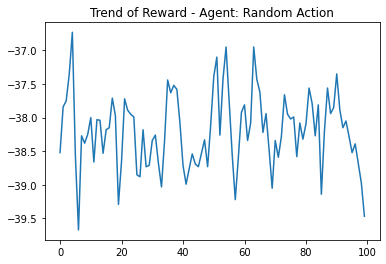

In [23]:
rewards_mean_random = []
for idx in range(0, episodes, episodes//100):
    mean = np.mean(full_rewards[idx : idx + 100])
    rewards_mean_random.append(mean)

plt.plot(list(range(len(rewards_mean_random))), rewards_mean_random)
plt.title("Trend of Reward - Agent: Random Action")
plt.show()

In [24]:
# Agent: All 3 Action

class Agent():
    
    def __init__(self, n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl):
        self.n_cols = n_cols
        self.n_rows = n_rows
        self.sl_coverage = sl_coverage
        self.md_coverage = md_coverage
        self.brightness_lvl = brightness_lvl
        self.SLM_class = StreetLightMaker(self.n_cols, self.n_rows, self.sl_coverage, self.md_coverage)

    @staticmethod
    def action(obs, list_sl_loc, brightness_lvl):
        action = []
        for idx_sl in range(len(list_sl_loc)):
            brightness = 3
            action.append(brightness)
        return action

In [25]:
random.seed(21)
agent = Agent(n_rows, n_cols, sl_coverage, md_coverage, brightness_lvl)
print('final test - agent: all 3 action')

pm = PedestriansMaker(n_rows, n_cols, positions, num_of_pedestrian, tds)
slm = StreetLightMaker(n_rows, n_cols, sl_coverage, md_coverage)
agent = Agent(n_rows, n_cols, sl_coverage, md_coverage, brightness_lvl)
env = Environment(n_rows, n_cols, positions, num_of_pedestrian, tds, sl_coverage, md_coverage, nl_opt)

full_actions = []
full_rewards = []
for i in range(episodes):
    total_reward = 0
    done = False
    obs = env.reset()
    episode_actions = []
    while not done:
        action = agent.action(obs, slm.list_sl_loc, brightness_lvl)
        new_obs, done, reward, info = env.step(action)
        total_reward += reward
        obs = new_obs
        episode_actions.append(",".join([str(x) for x in action]))
        print('obs: {}'.format(new_obs))
        print('info: {}'.format(info))
        print('reward: {}'.format(reward))
    full_actions.append("|".join([str(x) for x in episode_actions]))
    full_rewards.append(total_reward)

final test - agent: all 3 action
obs: [0, 0, 0]
info: {'time': 1, 'action': [3, 3, 3], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(0, 0), (1, 0), (10, 0), (10, 0)]}
reward: -6
obs: [0, 0, 0]
info: {'time': 2, 'action': [3, 3, 3], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(0, 0), (2, 0), (10, 0), (10, 0)]}
reward: -6
obs: [0, 0, 0]
info: {'time': 3, 'action': [3, 3, 3], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(0, 0), (3, 0), (9, 0), (10, 0)]}
reward: -6
obs: [0, 0, 0]
info: {'time': 4, 'action': [3, 3, 3], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(1, 0), (4, 0), (8, 0), (9, 0)]}
reward: -6
obs: [0, 0, 0]
info: {'time': 5, 'action': [3, 3, 3], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(2, 0), (5, 0), (7, 0), (8, 0)]}
reward: -6
obs: [0, 0, 0]
info: {'time': 6, 'action': [3, 3, 3], 'sl pedestrian count': [1, 1, 1], 'curent pedestrian loc': [(3, 0), (6, 0), (6, 0), (7, 0)]}
reward: -6
obs: [0, 0, 0]

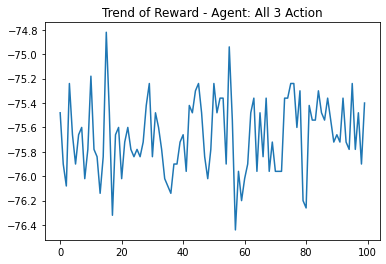

In [26]:
rewards_mean_all_3 = []
for idx in range(0, episodes, episodes//100):
    mean = np.mean(full_rewards[idx : idx + 100])
    rewards_mean_all_3.append(mean)

plt.plot(list(range(len(rewards_mean_all_3))), rewards_mean_all_3)
plt.title("Trend of Reward - Agent: All 3 Action")
plt.show()

In [27]:
# agent: qlearning
import itertools
from os import stat
import numpy as np

# variables
episodes = 6000      # total number of episodes
alpha = 0.3         # learning rate
gamma = 0.7         # discount factor

class Agent():
    
    def __init__(self, n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl):
        self.n_cols = n_cols
        self.n_rows = n_rows
        self.sl_coverage = sl_coverage
        self.md_coverage = md_coverage
        self.brightness_lvl = brightness_lvl
        self.SLM_class = StreetLightMaker(self.n_cols, self.n_rows, self.sl_coverage, self.md_coverage)
        self.state_space = 2 ** len(self.SLM_class.list_sl_loc)
        self.action_space = 3 ** len(self.SLM_class.list_sl_loc)
        self.qtable = np.zeros([self.state_space, self.action_space])
    
    @staticmethod
    def state_idx(state):
        state_bin = ''.join(map(str,state))
        state_idx = 0
        for idx in range(len(state_bin)):
            i = len(state_bin) - 1 - idx
            state_idx += int(state_bin[i]) * (2 ** idx)
        return state_idx

    @staticmethod
    def idx_state(state_idx, list_sl_loc):
        state = np.zeros(len(list_sl_loc))
        state_bin = list(bin(state_idx))
        del state_bin[0:2]
        state_bin = list(map(int, state_bin))
        for idx_bin in range(len(state_bin)):
            state_len = len(list_sl_loc)
            idx = state_len - 1 - idx_bin
            idx_bin = len(state_bin) - 1 - idx_bin
            state[idx] = state_bin[idx_bin]
        return state

    @staticmethod
    def action_idx(action):
        action_copy = np.array(action)
        action_copy.fill(1)
        action_update = action - action_copy
        action_ter = ''.join(map(str, action_update))
        action_idx = 0
        for idx in range(len(action_ter)):
            i = len(action_ter) - 1 - idx
            action_idx += int(action_ter[i]) * (3 ** idx)
        return action_idx

    @staticmethod
    def idx_action(action_idx, list_sl_loc): # currently not used
        action_ter = np.zeros(len(list_sl_loc))
        current_idx = action_idx
        for idx in range(len(action_ter)):
            reminder = current_idx % 3
            action_ter[len(action_ter) - 1 - idx] = reminder
            current_idx = current_idx // 3
        action_copy = np.array(action_ter)
        action_copy.fill(1)
        action = action_ter + action_copy
        return list(map(int, action))
        
    def learn(self, qtable, obs, action, alpha, gamma, reward, new_obs):
        state_idx = self.state_idx(obs)
        action_idx = self.action_idx(action)
        new_state_idx = self.state_idx(new_obs)
        old_value = qtable[state_idx, action_idx]
        qtable[state_idx, action_idx] = old_value + (alpha * (reward + (gamma * np.max(qtable[new_state_idx, :])) - old_value))
        return qtable

    def action(self, qtable, obs, list_sl_loc, brightness_lvl):
        state_idx = self.state_idx(obs)
        action_idx = np.random.choice(np.flatnonzero(qtable[state_idx, :] == qtable[state_idx, :].max()))
        action = self.idx_action(action_idx, list_sl_loc)
        return action


In [28]:
random.seed(21)
agent = Agent(n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl)
qtable = agent.qtable
print('final test - agent: qlearning')

pm = PedestriansMaker(n_cols, n_rows, positions, num_of_pedestrian, tds)
slm = StreetLightMaker(n_cols, n_rows, sl_coverage, md_coverage)
agent = Agent(n_cols, n_rows, sl_coverage, md_coverage, brightness_lvl)
env = Environment(n_cols, n_rows, positions, num_of_pedestrian, tds, sl_coverage, md_coverage, nl_opt)

full_actions = []
full_rewards = []
for i in range(episodes):
    total_reward = 0
    done = False
    obs = env.reset()
    episode_actions = []
    while not done:
        action = agent.action(qtable, obs, agent.SLM_class.list_sl_loc, brightness_lvl)
        new_obs, done, reward, info = env.step(action)
        total_reward += reward
        qtable = agent.learn(qtable, obs, action, alpha, gamma, reward, new_obs)
        obs = new_obs
        episode_actions.append(",".join([str(x) for x in action]))
        print('obs: {}'.format(new_obs))
        print('info: {}'.format(info))
        print('reward: {}'.format(reward))
    print('qtable {}'.format(i+1))
    full_actions.append("|".join([str(x) for x in episode_actions]))
    full_rewards.append(total_reward)

final test - agent: qlearning
obs: [1, 0, 0]
info: {'time': 1, 'action': [3, 1, 3], 'sl pedestrian count': [2, 1, 1], 'curent pedestrian loc': [(0, 0), (1, 0), (10, 0), (10, 0)]}
reward: -3
obs: [1, 0, 0]
info: {'time': 2, 'action': [1, 1, 2], 'sl pedestrian count': [2, 1, 1], 'curent pedestrian loc': [(0, 0), (2, 0), (10, 0), (10, 0)]}
reward: -2
obs: [1, 0, 1]
info: {'time': 3, 'action': [3, 3, 1], 'sl pedestrian count': [2, 1, 2], 'curent pedestrian loc': [(0, 0), (3, 0), (9, 0), (10, 0)]}
reward: -4
obs: [1, 1, 1]
info: {'time': 4, 'action': [2, 2, 1], 'sl pedestrian count': [2, 2, 3], 'curent pedestrian loc': [(1, 0), (4, 0), (8, 0), (9, 0)]}
reward: -2
obs: [1, 1, 1]
info: {'time': 5, 'action': [3, 1, 3], 'sl pedestrian count': [2, 2, 3], 'curent pedestrian loc': [(2, 0), (5, 0), (7, 0), (8, 0)]}
reward: -2
obs: [1, 1, 1]
info: {'time': 6, 'action': [2, 3, 2], 'sl pedestrian count': [2, 3, 2], 'curent pedestrian loc': [(3, 0), (6, 0), (6, 0), (7, 0)]}
reward: 0
obs: [0, 1, 1]
inf

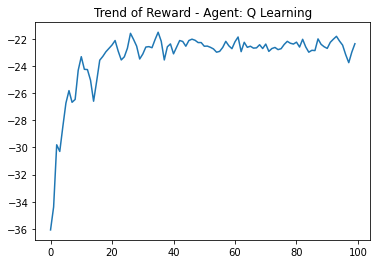

In [29]:
rewards_mean_qlearning = []
for idx in range(0, episodes, episodes//100):
    mean = np.mean(full_rewards[idx : idx + 100])
    rewards_mean_qlearning.append(mean)

plt.plot(list(range(len(rewards_mean_qlearning))), rewards_mean_qlearning)
plt.title("Trend of Reward - Agent: Q Learning")
plt.show()

/var/folders/qn/9bbd28_j67g33m6x99411d1w0000gn/T/ipykernel_41427/2840198580.py:19: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


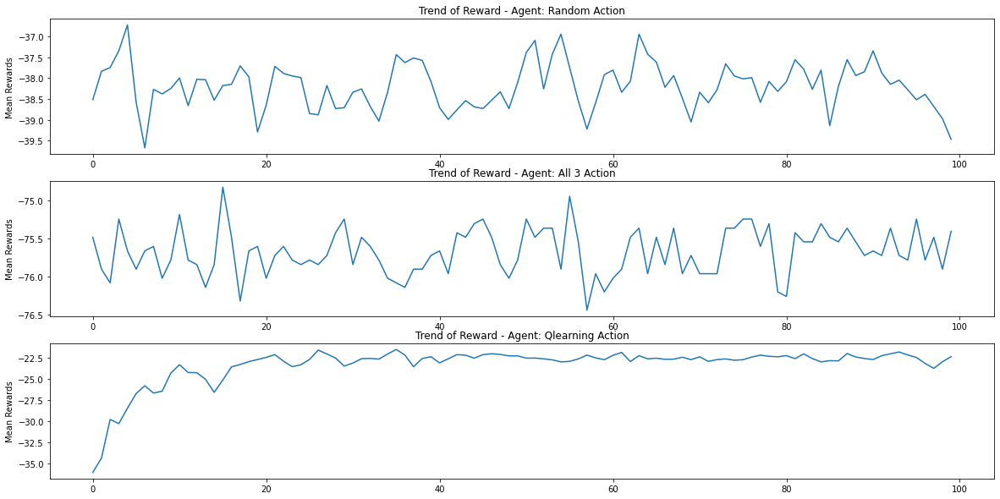

In [30]:
random = rewards_mean_random
all_3 = rewards_mean_all_3
qlearning = rewards_mean_qlearning

fig, ax = plt.subplots(nrows = 3, ncols=1, figsize=(20, 10))

ax[0].plot(list(range(len(random))), random)
ax[0].set_title("Trend of Reward - Agent: Random Action")
ax[0].set_ylabel("Mean Rewards")

ax[1].plot(list(range(len(all_3))), all_3)
ax[1].set_title("Trend of Reward - Agent: All 3 Action")
ax[1].set_ylabel("Mean Rewards")

ax[2].plot(list(range(len(qlearning))), qlearning)
ax[2].set_title("Trend of Reward - Agent: Qlearning Action")
ax[2].set_ylabel("Mean Rewards")

fig.show()

In [18]:
for i in range(agent.state_space):
    print(i)
    print('state: {}'.format(agent.idx_state(i, agent.SLM_class.list_sl_loc)))
    print('optimum action: {}'.format(agent.idx_action(qtable[i].argmax(), agent.SLM_class.list_sl_loc)))

0
state: [0. 0. 0.]
optimum action: [2, 1, 2]
1
state: [0. 0. 1.]
optimum action: [1, 1, 2]
2
state: [0. 1. 0.]
optimum action: [2, 3, 2]
3
state: [0. 1. 1.]
optimum action: [1, 2, 2]
4
state: [1. 0. 0.]
optimum action: [3, 1, 1]
5
state: [1. 0. 1.]
optimum action: [2, 1, 2]
6
state: [1. 1. 0.]
optimum action: [2, 3, 1]
7
state: [1. 1. 1.]
optimum action: [2, 2, 2]


In [ ]:
x = [1,2,3,2,1]

plt.plot(list(range(len(x))), x)
plt.title("Trend of Reward")
plt.show()

In [ ]:
reward = [1,2,3,4,7,4,5,3]
actions = [1,1,1,2,2,3,3,3,3,3]
foo = [2,3,4]

fig, ax = plt.subplots(nrows = 3, ncols=1, figsize=(20, 10))

ax[0].plot(list(range(len(reward))), reward)
ax[0].set_title("Trend of Reward - Agent: Random Action")

ax[1].plot(list(range(len(actions))), actions)
ax[1].set_title("Trend of Reward - Agent: Random Action")

ax[2].plot(list(range(len(foo))), foo)
ax[2].set_title("Trend of Reward - Agent: Random Action")

fig.show()